<a href="https://colab.research.google.com/github/s-laverty/hamiltonian-nn/blob/main/swinging_atwoods_machine.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Hamiltonian Neural Network ODE Solver

Author: Steven Laverty (lavers@rpi.edu)

# Concept

Using the method outlined in 
[this paper](https://scholar.harvard.edu/files/marios_matthaiakis/files/1904.08991.pdf), I've implemented an ordinary differential equation solver for the [Swinging Atwood's Machine system](https://en.wikipedia.org/wiki/Swinging_Atwood%27s_machine), which obeys the following Hamiltonian mechanics:

$$ \mathcal{H} = T + U = \frac{p_r^2}{2(M + m)} + \frac{p_\theta^2}{2mr^2} + Mgr - mgr \cos \theta $$

$$ \dot{r} = \frac{\partial \mathcal{H}}{p_r} = \frac{p_r}{M + m} $$

$$ \dot{\theta} = \frac{\partial \mathcal{H}}{p_\theta} = \frac{p_\theta}{mr^2} $$

$$ \dot{p_r} = -\frac{\partial \mathcal{H}}{r} = \frac{p_\theta^2}{mr^3} - Mg + mg \cos \theta $$


$$ \dot{p_\theta} = -\frac{\partial \mathcal{H}}{\theta} = -mgr \sin \theta$$

This set of equations is functioanally identical to the more familiar Euler-Lagrange equations, however this formalism does not require any second-order deritatives. Thus, it is more numerically stable.

The fundamental idea of a Hamiltonian Neural Network is that an artificial neural network can represent any arbitrary function in an analytically differentiable way. Thus, if we use a neural network $\vec{N}(t)$ to represent each of the above quantities, we can obtain:

$$
\vec{\hat{z}}(t) = \begin{bmatrix}\hat{r}(t) \\ \hat{\theta}(t) \\ \hat{p_r}(t) \\ \hat{p_\theta}(t) \end{bmatrix} = \vec{z}_0 + f(t) \vec{N}(t)
$$

In accordance with [this paper](https://scholar.harvard.edu/files/marios_matthaiakis/files/1904.08991.pdf), I used the following parametric function for $f(t)$:

$$ f(t) = 1 - e^{-t} $$

In the large-$t$ limit, $\vec{N}(t) = \vec{\hat{z}}(t) - \vec{z_0}$, so the neural network will directly simulate the Hamiltonian.

The loss function for this neural network is defined by the Hamiltonian. Because $\vec{\hat{z}}(t)$ is numerically differentiable via backpropagation, we can numericaly calculate $\dot{\vec{\hat{z}}}(t)$. We also have analytical expressions for these quantities using Hamilton's equations, which can be summarized compactly using matrix notation:

$$ \dot{\vec{\hat{z}}}(t) = J \nabla_{\vec{\hat{z}}}\mathcal{H}(\vec{\hat{z}}) \qquad \text{where} \qquad J = \begin{bmatrix}
0_{d \times d} & 1_{d \times d} \\
-1_{d \times d} & 0_{d \times d}
\end{bmatrix} $$

In the above expression, $1_{d \times d}$ is the identity matrix for $d$ generalized coordinates.

Both definitions of $\dot{\vec{\hat{z}}}(t)$ should be equivalent, therefore we define a loss function as the difference between them:

$$ L = \frac{1}{n} \sum_{i=1}^n \left(\dot{\vec{\hat{z}}}(t_i) - J \nabla_{\vec{\hat{z}}}\mathcal{H}(\vec{\hat{z}}(t_i)) \right)^2 $$

In addition to the approach outlined thus far, I tested modifying the loss function to also include the following term:

$$ L_\mathrm{aug} = L + \sum_{i=1}^n\left(\mathcal{H}(\vec{\hat{z}}(t_i)) - \mathcal{H}(\vec{z}_0)\right)^2 $$

My motivation for adding this term was that energy should be constant in time, so any variation from the initial energy $E_0$ should be penalized.

# Implementation

PyTorch's autograd library is flexible enough to permit the calculation of [any arbitrary vector-Jacobian product](https://pytorch.org/tutorials/beginner/blitz/autograd_tutorial.html). Thus, for a batched sequence of $n$ time inputs, I can efficiently calculate for generalized coordinate $\hat{z}_m(t)$:

$$ \dot{\hat{z}_m}(t) = J^\top \vec{v} = \begin{bmatrix}
\frac{\partial \hat{z}_{m1}}{\partial t_1} & 0 & \cdots & 0 \\
0 & \frac{\partial \hat{z}_{m2}}{\partial t_2} & \cdots & 0 \\
\vdots & \vdots & \ddots & \vdots \\
0 & 0 & \cdots & \frac{\partial \hat{z}_{mn}}{\partial t_n}
\end{bmatrix} \begin{bmatrix}
1 \\
1 \\
\vdots \\
1
\end{bmatrix} = \begin{bmatrix}
\frac{\partial \hat{z}_{m1}}{\partial t_1} \\
\frac{\partial \hat{z}_{m2}}{\partial t_2} \\
\vdots \\
\frac{\partial \hat{z}_{mn}}{\partial t_n}
\end{bmatrix} $$

By doing this $m$ times, I can efficiently calculate all the time derivatives I need.

## Generalized Hamiltonian Neural Network

In [6]:
import torch
from torch import nn
from scipy import integrate # RK4 integration for comparison
import numpy as np
import matplotlib.pyplot as plt # Plotting results
from matplotlib import animation

In [7]:
# Google colab imports
from google.colab import files
from matplotlib import rc
rc('animation', html='jshtml') # For rendering matplotlib animations in colab

In [8]:
# Get cpu or gpu device for training.
device = "cuda" if torch.cuda.is_available() else "cpu"

In [9]:
# Sine activation layer
class Sine(nn.Module):    
  def forward(self, x):
    return torch.sin(x)

# Feed-forward network
class FeedForwardNN(nn.Module):
  def __init__(self, d_hidden, n_hidden, d_out):
    super().__init__()
    self.linear_sin_stack = nn.Sequential(
        nn.Linear(1, d_hidden),
        Sine(),
        *[
         x for _ in range(n_hidden - 1) for x in
         [nn.Linear(d_hidden, d_hidden), Sine()]
        ],
        nn.Linear(d_hidden, d_out)
    )

  def forward(self, t):
    N = self.linear_sin_stack(t)
    return N

# Hamiltonian neural network
class HamiltonianNN(nn.Module):
  def __init__(self, z0, d_hidden, n_hidden):
    super().__init__()
    self.z0 = z0.detach().clone()
    self.feed_forward = FeedForwardNN(d_hidden, n_hidden, z0.size(0))

  # Parametric weight function for NN output
  @staticmethod
  def f(t):
    return 1 - torch.exp(-t)

  # Final prediction for z
  def forward(self, t):
    N = self.feed_forward(t)
    z = self.z0 + self.f(t) * N
    return z

In [10]:
# Define training function
def train(t, std, H, H_grad, model, loss_fn, optimizer):
  # Perturb time points with normal distribution
  t = t + torch.normal(0, std, t.size())
  t.requires_grad = True
  t = t.to(device)

  # Compute prediction error
  z = model(t)
  # Compute gradient of each item in z
  z_dot = torch.stack([
      torch.autograd.grad(z_i, t, torch.ones_like(z_i), create_graph=True)[0]
      for z_i in z.unbind(-1)
  ], -1).squeeze()

  # Compute the Hamiltonian of each item in z
  E_0 = H(model.z0)
  E = H(z)
  
  loss = loss_fn(z_dot - H_grad(z), torch.zeros_like(z)) + \
  loss_fn(E, E_0 * torch.ones_like(E)) # This term changes things a lot!

  # Backpropagation
  optimizer.zero_grad()
  loss.backward()
  optimizer.step()

  # Report loss
  return loss.item()


## Swinging Atwoods Machine

The Swinging Atwoods Machine obeys the following Hamiltonian:

$$ \mathcal{H} = T + U = \frac{p_r^2}{2(M + m)} + \frac{p_\theta^2}{2mr^2} + Mgr - mgr \cos \theta $$

Thus, the gradient of the Swinging Atwoods Machine is:

$$ \nabla \mathcal{H} = \begin{bmatrix}
\frac{\partial \mathcal{H}}{r} \\
\frac{\partial \mathcal{H}}{\theta} \\
\frac{\partial \mathcal{H}}{p_r} \\
\frac{\partial \mathcal{H}}{p_\theta}
\end{bmatrix} = \begin{bmatrix}
-\frac{p_\theta^2}{mr^3} + Mg - mg \cos \theta \\
mgr \sin \theta \\
\frac{p_r}{M + m} \\
\frac{p_\theta}{mr^2}
\end{bmatrix} $$

In [11]:
# Define swinging Atwoods Machine ODE Solver
class SwingingAtwoodsNNSolver():

  def __init__(self, M, m, d_hidden=64, n_hidden=2):
    self.g = 1 # Gravity
    self.M = M # Mass 1 (horizontally fixed)
    self.m = m # Mass 2 (swinging mass)
    self.d_hidden = d_hidden
    self.n_hidden = n_hidden
    self.loss_fn = nn.MSELoss() # Mean squared error loss

  def T(self, z):
    # The kinetic energy for the swinging Atwoods Machine
    r, theta, p_r, p_theta = z.unbind(-1)
    return p_r**2 / (2 * (self.M + self.m)) + p_theta**2 / (2 * self.m * r**2)

  def U(self, z):
    # The potential energy for the swinging Atwoods Machine
    r, theta, p_r, p_theta = z.unbind(-1)
    return self.g * (self.M - self.m * torch.cos(theta)) * r

  def H(self, z):
    # The Hamiltonian for the swinging Atwoods Machine
    return self.T(z) + self.U(z)

  def H_grad(self, z):
    # Determine the gradient of the Hamiltonian, then use Hamilton's equations:
    # dq/dt = dH/dp        dp/dt = - dH/dq
    r, theta, p_r, p_theta = z.unbind(-1)
    r_grad = -p_theta**2 / (self.m * r**3) \
      + self.g * (self.M - self.m * torch.cos(theta))
    theta_grad = self.m * self.g * r * torch.sin(theta)
    p_r_grad = p_r / (self.M + self.m)
    p_theta_grad = p_theta / (self.m * r**2)
    return torch.stack((p_r_grad, p_theta_grad, -r_grad, -theta_grad), -1)
  
  def init(self, z0, T, steps=100, std=None, lr=8e-3, gamma=0.9):
    # Initialize model
    if (std is None): std = T / steps * 0.5
    self.model = HamiltonianNN(z0, self.d_hidden, self.n_hidden)
    print(self.model)
    self.t = torch.linspace(0, T, steps)[:,None]
    self.std = std
    self.epochs = 0
    self.optimizer = torch.optim.Adam(self.model.parameters(), lr=lr)
    self.scheduler = torch.optim.lr_scheduler.ExponentialLR(
        self.optimizer, gamma=gamma)
    self.loss_history = []
  
  def load(self, f):
    # Load saved model
    checkpoint = torch.load(f)
    self.epochs = checkpoint['epoch']
    self.model.load_state_dict(checkpoint['model_state_dict'])
    self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    self.scheduler.load_state_dict(checkpoint['lr_scheduler_state_dict'])
    self.loss_history = checkpoint['train_loss_history']
    self.model.eval()
  
  def save(self, f):
    # Save current model
    torch.save({
      'epoch': self.epochs,
      'model_state_dict': self.model.state_dict(),
      'optimizer_state_dict': self.optimizer.state_dict(),
      'lr_scheduler_state_dict': self.scheduler.state_dict(),
      'train_loss_history': self.loss_history,
    }, f)

  def train(self, epochs=1000, report=50):
    # Train model
    print('Training for {} Epochs'.format(epochs))
    self.model.train()
    for i in range(1, epochs + 1):
      self.loss_history.append(train(
          self.t, self.std, self.H, self.H_grad,
          self.model, self.loss_fn, self.optimizer
      ))
      if report and i % report == 0:
        print('Epoch: {} / {}    MSE loss: {:.6f}'.format(i, epochs, self.loss_history[-1]))
      self.epochs += 1
      if self.epochs % 1000 == 0: self.scheduler.step()
    self.model.eval()
  
  def __call__(self, t):
    # Evaluate model at t
    t = torch.tensor(t, dtype=torch.float32)[:,None]
    with torch.no_grad():
      z = self.model(t)
    return z

# Testing

## Model 1

In [12]:
# Initialize a model with M = 2, m = 1 and initial conditions r=1, theta=pi/2
model1 = SwingingAtwoodsNNSolver(2, 1, d_hidden=64, n_hidden=2)
z0_1 = torch.tensor((1, torch.pi / 2, 0, 0))
model1.init(z0_1, 10, 400, lr=3e-3)

HamiltonianNN(
  (feed_forward): FeedForwardNN(
    (linear_sin_stack): Sequential(
      (0): Linear(in_features=1, out_features=64, bias=True)
      (1): Sine()
      (2): Linear(in_features=64, out_features=64, bias=True)
      (3): Sine()
      (4): Linear(in_features=64, out_features=4, bias=True)
    )
  )
)


In [13]:
# Solve the intial value problem using rk4 evaluated at 300 evenly-spaced points
rk45_1 = integrate.solve_ivp(lambda t, y: model1.H_grad(torch.tensor(y)), (0, 10), z0_1, t_eval=np.linspace(0, 10, 300))

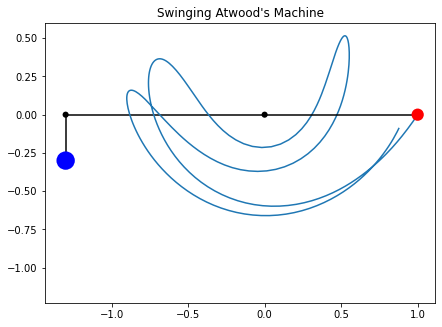

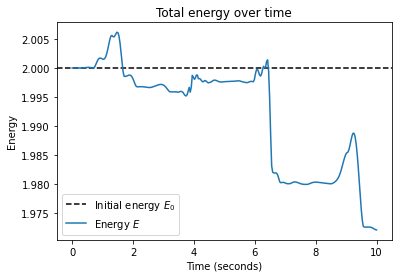

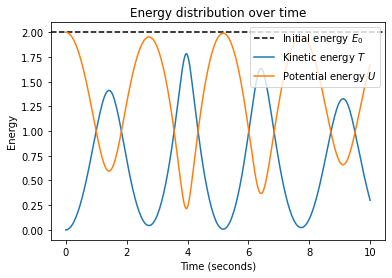

In [14]:
# Display results of rk4 evaluation
t = rk45_1.t
z = torch.tensor(rk45_1.y).T
r, theta = z.T[:2]
x = r * np.sin(theta)
y = -r * np.cos(theta)

fig = plt.figure(figsize=(7,7))
plt.title('Swinging Atwood\'s Machine')
ax = plt.gca()
ax.set_aspect(1)
W_x = -(max(r) + 0.3)
center_pulley = plt.Circle((0, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(center_pulley)
left_pulley = plt.Circle((W_x, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(left_pulley)
plt.plot((W_x, 0), (0, 0), 'k-')
plt.plot(x, y)

w_line, W_line = ax.plot((), (), 'k-', (), (), 'k-')
w = plt.Circle((0, 0), 0.04, fc='red', zorder=np.inf)
W = plt.Circle((0, min(r) + W_x), 0.06, fc='blue', zorder=np.inf)
ax.add_patch(w)
ax.add_patch(W)

def animate(i):
  w_line_x = [0, x[i]]
  w_line_y = [0, y[i]]
  w_line.set_data(w_line_x, w_line_y)
  w.set(center=(x[i], y[i]))
  W_line_x = [W_x, W_x]
  W_line_y = [0, r[i] + W_x]
  W_line.set_data(W_line_x, W_line_y)
  W.set(center=(W_x, r[i] + W_x))
  return w_line, W_line, w, W
anim = animation.FuncAnimation(
    fig, animate, len(t), interval = 10 * 1000 / len(t), blit=True, repeat=True)
plt.show()

# Change in total energy
E = model1.H(z)
plt.figure()
plt.title('Total energy over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, E, label='Energy $E$')
plt.legend()
plt.show()

# Kinetic and potential energy over time
T = model1.T(z)
U = model1.U(z)
plt.figure()
plt.title('Energy distribution over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, T, label='Kinetic energy $T$')
plt.plot(t, U, label='Potential energy $U$')
plt.legend()
plt.show()

In [ ]:
# Display animation in google colab
anim

In [15]:
# Load model 1 data
model1.load('model1.pth')

In [ ]:
# Train model 1
model1.train(int(1e4))
print(model1.epochs)

Training for 10000 Epochs
Epoch: 50 / 10000    MSE loss: 0.000407
Epoch: 100 / 10000    MSE loss: 0.000411
Epoch: 150 / 10000    MSE loss: 0.000403
Epoch: 200 / 10000    MSE loss: 0.000415
Epoch: 250 / 10000    MSE loss: 0.000418
Epoch: 300 / 10000    MSE loss: 0.000406
Epoch: 350 / 10000    MSE loss: 0.000408
Epoch: 400 / 10000    MSE loss: 0.000418
Epoch: 450 / 10000    MSE loss: 0.000416
Epoch: 500 / 10000    MSE loss: 0.000412
Epoch: 550 / 10000    MSE loss: 0.000408
Epoch: 600 / 10000    MSE loss: 0.000414
Epoch: 650 / 10000    MSE loss: 0.000404
Epoch: 700 / 10000    MSE loss: 0.000407
Epoch: 750 / 10000    MSE loss: 0.000404
Epoch: 800 / 10000    MSE loss: 0.000406
Epoch: 850 / 10000    MSE loss: 0.000406
Epoch: 900 / 10000    MSE loss: 0.000410
Epoch: 950 / 10000    MSE loss: 0.000405
Epoch: 1000 / 10000    MSE loss: 0.000408
Epoch: 1050 / 10000    MSE loss: 0.000404
Epoch: 1100 / 10000    MSE loss: 0.000407
Epoch: 1150 / 10000    MSE loss: 0.000408
Epoch: 1200 / 10000    MSE l

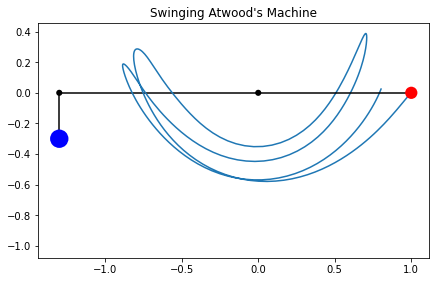

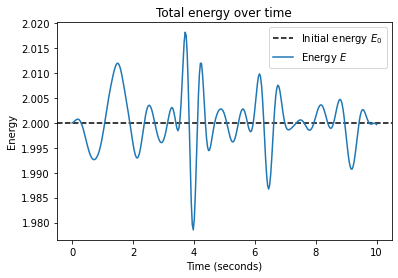

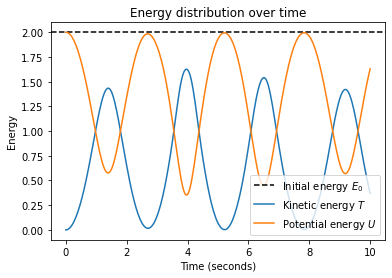

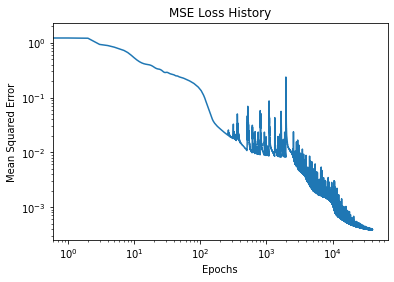

In [16]:
# Display results of NN ODE evaluation
t = np.linspace(0, 10, 300)
z = model1(t)
r, theta = z.T[:2]
x = r * np.sin(theta)
y = -r * np.cos(theta)

fig = plt.figure(figsize=(7,7))
plt.title('Swinging Atwood\'s Machine')
ax = plt.gca()
ax.set_aspect(1)
W_x = -(max(r) + 0.3)
center_pulley = plt.Circle((0, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(center_pulley)
left_pulley = plt.Circle((W_x, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(left_pulley)
plt.plot((W_x, 0), (0, 0), 'k-')
plt.plot(x, y)

w_line, W_line = ax.plot((), (), 'k-', (), (), 'k-')
w = plt.Circle((0, 0), 0.04, fc='red', zorder=np.inf)
W = plt.Circle((0, min(r) + W_x), 0.06, fc='blue', zorder=np.inf)
ax.add_patch(w)
ax.add_patch(W)

def animate(i):
  w_line_x = [0, x[i]]
  w_line_y = [0, y[i]]
  w_line.set_data(w_line_x, w_line_y)
  w.set(center=(x[i], y[i]))
  W_line_x = [W_x, W_x]
  W_line_y = [0, r[i] + W_x]
  W_line.set_data(W_line_x, W_line_y)
  W.set(center=(W_x, r[i] + W_x))
  return w_line, W_line, w, W
anim = animation.FuncAnimation(
    fig, animate, len(t), interval = 10 * 1000 / len(t), blit=True, repeat=True)
plt.show()

# Change in total energy
E = model1.H(z)
plt.figure()
plt.title('Total energy over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, E, label='Energy $E$')
plt.legend()
plt.show()

# Kinetic and potential energy over time
T = model1.T(z)
U = model1.U(z)
plt.figure()
plt.title('Energy distribution over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, T, label='Kinetic energy $T$')
plt.plot(t, U, label='Potential energy $U$')
plt.legend()
plt.show()

# Display loss history
plt.figure()
plt.title('MSE Loss History')
plt.xlabel('Epochs')
plt.ylabel('Mean Squared Error')
plt.xscale('log')
plt.yscale('log')
plt.plot(model1.loss_history)
plt.show()

In [ ]:
# Display animation in google colab
anim

In [ ]:
# Save model 1
model1.save('model1.pth')
files.download('model1.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Model 2

In [17]:
# Initialize a model with M = 3, m = 1 and initial conditions r=1, theta=pi/2
model2 = SwingingAtwoodsNNSolver(3, 1, d_hidden=64, n_hidden=2)
z0_2 = torch.tensor((1, torch.pi / 2, 0, 0))
model2.init(z0_2, 10, 400, lr=3e-3)

HamiltonianNN(
  (feed_forward): FeedForwardNN(
    (linear_sin_stack): Sequential(
      (0): Linear(in_features=1, out_features=64, bias=True)
      (1): Sine()
      (2): Linear(in_features=64, out_features=64, bias=True)
      (3): Sine()
      (4): Linear(in_features=64, out_features=4, bias=True)
    )
  )
)


In [18]:
# Solve the intial value problem using rk4 evaluated at 300 evenly-spaced points
rk45_2 = integrate.solve_ivp(lambda t, y: model2.H_grad(torch.tensor(y)), (0, 10), z0_2, t_eval=np.linspace(0, 10, 300))

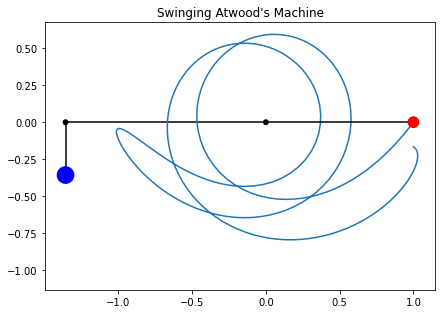

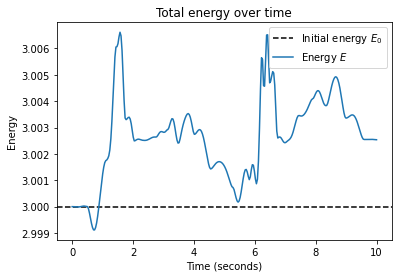

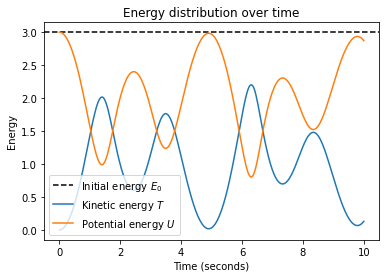

In [19]:
# Display results of rk4 evaluation
t = rk45_2.t
z = torch.tensor(rk45_2.y).T
r, theta = z.T[:2]
x = r * np.sin(theta)
y = -r * np.cos(theta)

fig = plt.figure(figsize=(7,7))
plt.title('Swinging Atwood\'s Machine')
ax = plt.gca()
ax.set_aspect(1)
W_x = -(max(r) + 0.3)
center_pulley = plt.Circle((0, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(center_pulley)
left_pulley = plt.Circle((W_x, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(left_pulley)
plt.plot((W_x, 0), (0, 0), 'k-')
plt.plot(x, y)

w_line, W_line = ax.plot((), (), 'k-', (), (), 'k-')
w = plt.Circle((0, 0), 0.04, fc='red', zorder=np.inf)
W = plt.Circle((0, min(r) + W_x), 0.06, fc='blue', zorder=np.inf)
ax.add_patch(w)
ax.add_patch(W)

def animate(i):
  w_line_x = [0, x[i]]
  w_line_y = [0, y[i]]
  w_line.set_data(w_line_x, w_line_y)
  w.set(center=(x[i], y[i]))
  W_line_x = [W_x, W_x]
  W_line_y = [0, r[i] + W_x]
  W_line.set_data(W_line_x, W_line_y)
  W.set(center=(W_x, r[i] + W_x))
  return w_line, W_line, w, W
anim = animation.FuncAnimation(
    fig, animate, len(t), interval = 10 * 1000 / len(t), blit=True, repeat=True)
plt.show()

# Change in total energy
E = model2.H(z)
plt.figure()
plt.title('Total energy over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, E, label='Energy $E$')
plt.legend()
plt.show()

# Kinetic and potential energy over time
T = model2.T(z)
U = model2.U(z)
plt.figure()
plt.title('Energy distribution over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, T, label='Kinetic energy $T$')
plt.plot(t, U, label='Potential energy $U$')
plt.legend()
plt.show()

In [ ]:
# Display animation in google colab
anim

In [20]:
# Load model 2 data
model2.load('model2.pth')

In [ ]:
# Train model 2
model2.train(int(2e4))
print(model2.epochs)

Training for 20000 Epochs
Epoch: 50 / 20000    MSE loss: 0.007028
Epoch: 100 / 20000    MSE loss: 0.007095
Epoch: 150 / 20000    MSE loss: 0.007035
Epoch: 200 / 20000    MSE loss: 0.007198
Epoch: 250 / 20000    MSE loss: 0.007087
Epoch: 300 / 20000    MSE loss: 0.007030
Epoch: 350 / 20000    MSE loss: 0.007054
Epoch: 400 / 20000    MSE loss: 0.006961
Epoch: 450 / 20000    MSE loss: 0.007152
Epoch: 500 / 20000    MSE loss: 0.006987
Epoch: 550 / 20000    MSE loss: 0.007021
Epoch: 600 / 20000    MSE loss: 0.007035
Epoch: 650 / 20000    MSE loss: 0.007120
Epoch: 700 / 20000    MSE loss: 0.007207
Epoch: 750 / 20000    MSE loss: 0.007032
Epoch: 800 / 20000    MSE loss: 0.007094
Epoch: 850 / 20000    MSE loss: 0.007066
Epoch: 900 / 20000    MSE loss: 0.007013
Epoch: 950 / 20000    MSE loss: 0.007012
Epoch: 1000 / 20000    MSE loss: 0.006999
Epoch: 1050 / 20000    MSE loss: 0.006994
Epoch: 1100 / 20000    MSE loss: 0.006984
Epoch: 1150 / 20000    MSE loss: 0.006952
Epoch: 1200 / 20000    MSE l

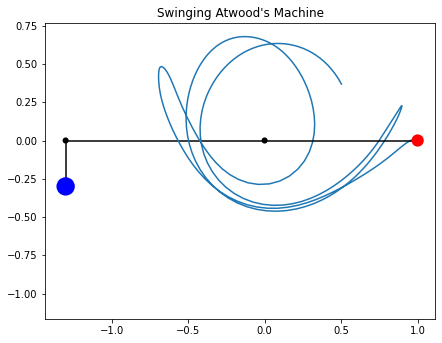

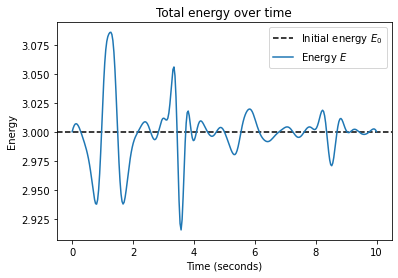

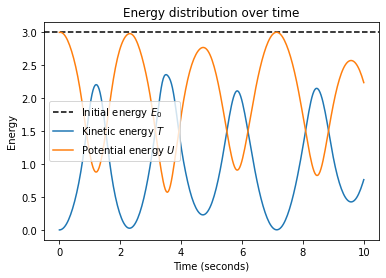

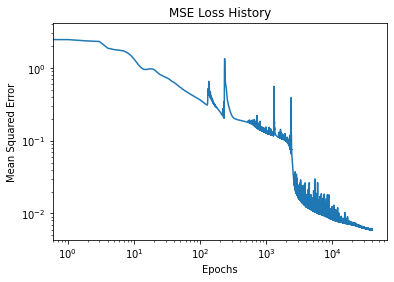

In [21]:
# Display results of NN ODE evaluation
t = np.linspace(0, 10, 300)
z = model2(t)
r, theta = z.T[:2]
x = r * np.sin(theta)
y = -r * np.cos(theta)

fig = plt.figure(figsize=(7,7))
plt.title('Swinging Atwood\'s Machine')
ax = plt.gca()
ax.set_aspect(1)
W_x = -(max(r) + 0.3)
center_pulley = plt.Circle((0, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(center_pulley)
left_pulley = plt.Circle((W_x, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(left_pulley)
plt.plot((W_x, 0), (0, 0), 'k-')
plt.plot(x, y)

w_line, W_line = ax.plot((), (), 'k-', (), (), 'k-')
w = plt.Circle((0, 0), 0.04, fc='red', zorder=np.inf)
W = plt.Circle((0, min(r) + W_x), 0.06, fc='blue', zorder=np.inf)
ax.add_patch(w)
ax.add_patch(W)

def animate(i):
  w_line_x = [0, x[i]]
  w_line_y = [0, y[i]]
  w_line.set_data(w_line_x, w_line_y)
  w.set(center=(x[i], y[i]))
  W_line_x = [W_x, W_x]
  W_line_y = [0, r[i] + W_x]
  W_line.set_data(W_line_x, W_line_y)
  W.set(center=(W_x, r[i] + W_x))
  return w_line, W_line, w, W
anim = animation.FuncAnimation(
    fig, animate, len(t), interval = 10 * 1000 / len(t), blit=True, repeat=True)
plt.show()

# Change in total energy
E = model2.H(z)
plt.figure()
plt.title('Total energy over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, E, label='Energy $E$')
plt.legend()
plt.show()

# Kinetic and potential energy over time
T = model2.T(z)
U = model2.U(z)
plt.figure()
plt.title('Energy distribution over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, T, label='Kinetic energy $T$')
plt.plot(t, U, label='Potential energy $U$')
plt.legend()
plt.show()

# Display loss history
plt.figure()
plt.title('MSE Loss History')
plt.xlabel('Epochs')
plt.ylabel('Mean Squared Error')
plt.xscale('log')
plt.yscale('log')
plt.plot(model2.loss_history)
plt.show()

In [ ]:
# Display animation in google colab
anim

In [ ]:
# Save model 2
model2.save('model2.pth')
files.download('model2.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Evaluations

## Training

Similar to the results in [this paper](https://scholar.harvard.edu/files/marios_matthaiakis/files/1904.08991.pdf), my models tended to converge on the order of $10^4$ training batches using the Adam optimizer.

### Learning rate schedule

The Hamiltonian Neural network encountered various issues during training. Firstly, it became rapidly evident that a dynamic learning rate schedule was necessary. I chose to add an exponentially-decaying learning rate scheduler that would decrease the learning rate by 10% every 1000 batches. The results of this design choice can be seen in the loss history graphs above.

### Augmented loss function

By modifying the original loss function to include an energy term:

$$ L_\mathrm{aug} = L + \sum_{i=1}^n\left(\mathcal{H}(\vec{\hat{z}}(t_i)) - \mathcal{H}(\vec{z}_0)\right)^2 $$

My model performed significantly better in terms of conserving energy. As a direct comparison, for model 1:

In [29]:
model1_wo_E = SwingingAtwoodsNNSolver(2, 1, d_hidden=64, n_hidden=2)
model1_wo_E.init(z0_1, 10, 400, lr=3e-3)
model1_wo_E.load('model1_wo_E.pth')

HamiltonianNN(
  (feed_forward): FeedForwardNN(
    (linear_sin_stack): Sequential(
      (0): Linear(in_features=1, out_features=64, bias=True)
      (1): Sine()
      (2): Linear(in_features=64, out_features=64, bias=True)
      (3): Sine()
      (4): Linear(in_features=64, out_features=4, bias=True)
    )
  )
)


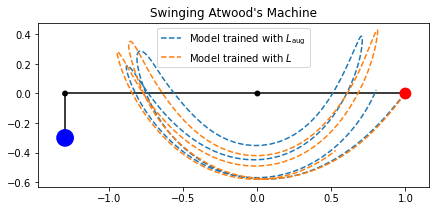

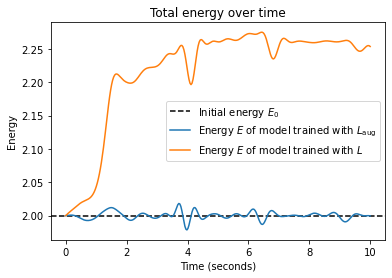

In [44]:
# Display results of NN ODE evaluation
t = np.linspace(0, 10, 300)
z_1 = model1(t)
r_1, theta_1 = z_1.T[:2]
x_1 = r_1 * np.sin(theta_1)
y_1 = -r_1 * np.cos(theta_1)
z_2 = model1_wo_E(t)
r_2, theta_2 = z_2.T[:2]
x_2 = r_2 * np.sin(theta_2)
y_2 = -r_2 * np.cos(theta_2)

fig = plt.figure(figsize=(7,7))
plt.title('Swinging Atwood\'s Machine')
ax = plt.gca()
ax.set_aspect(1)
W_x = -(max(torch.cat((r_1, r_2))) + 0.3)
center_pulley = plt.Circle((0, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(center_pulley)
left_pulley = plt.Circle((W_x, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(left_pulley)
plt.plot((W_x, 0), (0, 0), 'k-')
w = plt.Circle((x_1[0], y_1[0]), 0.04, fc='red', zorder=np.inf)
ax.add_patch(w)
plt.plot((0, x_1[0]), (0, y_1[0]), 'k-')
W = plt.Circle((W_x, r_1[0] + W_x), 0.06, fc='blue', zorder=np.inf)
ax.add_patch(W)
plt.plot((W_x, W_x), (0, r_1[0] + W_x), 'k-')

plt.plot(x_1, y_1, '--', label='Model trained with $L_\mathrm{aug}$')
plt.plot(x_2, y_2, '--', label='Model trained with $L$')
plt.legend()
plt.show()

# Change in total energy
E_1 = model1.H(z_1)
E_2 = model1_wo_E.H(z_2)
plt.figure()
plt.title('Total energy over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E_1[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, E_1, label='Energy $E$ of model trained with $L_\mathrm{aug}$')
plt.plot(t, E_2, label='Energy $E$ of model trained with $L$')
plt.legend()
plt.show()

Clearly, using the augmented loss yielded a more energetically stable solution overall.

### Local minima

Another problem I encountered with this approach was that the neural network tended to encounter local minima that it could not escape. In this particular system, there is a centrifugal barrier on the $r$ coordinate that prevents the neural network from approaching low values of $r$. Thus, it seems to get trapped in local minima by attempting to maximize $r$ in all cases. This is especially clear in model 2.

## ODE Solver

Overall, the Hamiltonian neural network was able to generate feasibly physical solutions by adapting initally random trajectories about $z_0$. In principle, this functions as a numerical ODE solver. Below, I'll show qualitative and quantitative comparisons with a traditional ODE Solver, the RK4 algorithm:

### Model 1

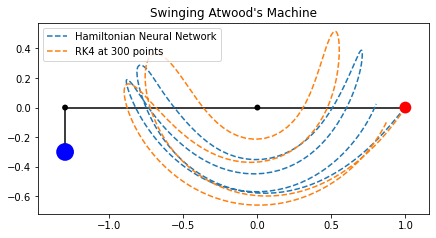

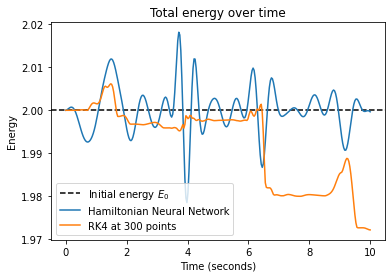

In [50]:
# Display results of NN ODE evaluation
t = np.linspace(0, 10, 300)
z_1 = model1(t)
r_1, theta_1 = z_1.T[:2]
x_1 = r_1 * np.sin(theta_1)
y_1 = -r_1 * np.cos(theta_1)
z_2 = torch.tensor(rk45_1.y).T
r_2, theta_2 = z_2.T[:2]
x_2 = r_2 * np.sin(theta_2)
y_2 = -r_2 * np.cos(theta_2)

fig = plt.figure(figsize=(7,7))
plt.title('Swinging Atwood\'s Machine')
ax = plt.gca()
ax.set_aspect(1)
W_x = -(max(torch.cat((r_1, r_2))) + 0.3)
center_pulley = plt.Circle((0, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(center_pulley)
left_pulley = plt.Circle((W_x, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(left_pulley)
plt.plot((W_x, 0), (0, 0), 'k-')
w = plt.Circle((x_1[0], y_1[0]), 0.04, fc='red', zorder=np.inf)
ax.add_patch(w)
plt.plot((0, x_1[0]), (0, y_1[0]), 'k-')
W = plt.Circle((W_x, r_1[0] + W_x), 0.06, fc='blue', zorder=np.inf)
ax.add_patch(W)
plt.plot((W_x, W_x), (0, r_1[0] + W_x), 'k-')

plt.plot(x_1, y_1, '--', label='Hamiltonian Neural Network')
plt.plot(x_2, y_2, '--', label='RK4 at 300 points')
plt.legend()
plt.show()

# Change in total energy
E_1 = model1.H(z_1)
E_2 = model1.H(z_2)
plt.figure()
plt.title('Total energy over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E_1[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, E_1, label='Hamiltonian Neural Network')
plt.plot(t, E_2, label='RK4 at 300 points')
plt.legend()
plt.show()

Clearly, the Hamiltonian Neural Network solver is better at conserving energy over time.

### Model 2

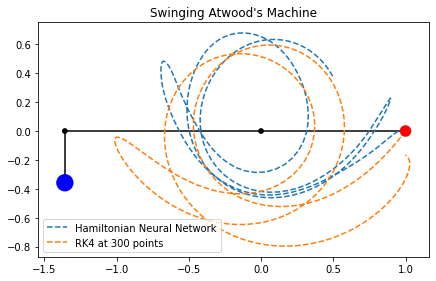

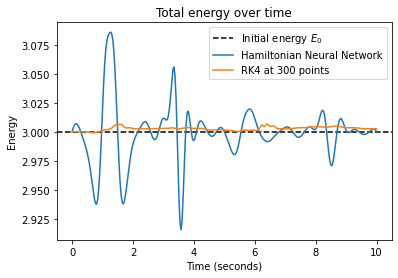

In [49]:
# Display results of NN ODE evaluation
t = np.linspace(0, 10, 300)
z_1 = model2(t)
r_1, theta_1 = z_1.T[:2]
x_1 = r_1 * np.sin(theta_1)
y_1 = -r_1 * np.cos(theta_1)
z_2 = torch.tensor(rk45_2.y).T
r_2, theta_2 = z_2.T[:2]
x_2 = r_2 * np.sin(theta_2)
y_2 = -r_2 * np.cos(theta_2)

fig = plt.figure(figsize=(7,7))
plt.title('Swinging Atwood\'s Machine')
ax = plt.gca()
ax.set_aspect(1)
W_x = -(max(torch.cat((r_1, r_2))) + 0.3)
center_pulley = plt.Circle((0, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(center_pulley)
left_pulley = plt.Circle((W_x, 0), 0.02, fc='black', zorder=np.inf)
ax.add_patch(left_pulley)
plt.plot((W_x, 0), (0, 0), 'k-')
w = plt.Circle((x_1[0], y_1[0]), 0.04, fc='red', zorder=np.inf)
ax.add_patch(w)
plt.plot((0, x_1[0]), (0, y_1[0]), 'k-')
W = plt.Circle((W_x, r_1[0] + W_x), 0.06, fc='blue', zorder=np.inf)
ax.add_patch(W)
plt.plot((W_x, W_x), (0, r_1[0] + W_x), 'k-')

plt.plot(x_1, y_1, '--', label='Hamiltonian Neural Network')
plt.plot(x_2, y_2, '--', label='RK4 at 300 points')
plt.legend()
plt.show()

# Change in total energy
E_1 = model2.H(z_1)
E_2 = model2.H(z_2)
plt.figure()
plt.title('Total energy over time')
plt.xlabel('Time (seconds)')
plt.ylabel('Energy')
plt.axhline(E_1[0], c='k', ls='--', label='Initial energy $E_0$')
plt.plot(t, E_1, label='Hamiltonian Neural Network')
plt.plot(t, E_2, label='RK4 at 300 points')
plt.legend()
plt.show()

In this case, we can see an example of where the Hamiltonian Neural Network's performance suffered in comparison to the more conventional RK4 numerical integration. We can see how the loss plateuad and the neural network failed to get out of a local minimum and find a global mininum loss as in model 1.

## Unique Advantages

Neural network ODE solvers possess some unique advantages over traditional numerical integration algorithms. For one, they yield a differentiable analytic function of $t$, which, unlike a series of points, does NOT require interpolation. Furthermore, numerical derivatives can be calculated exactly, rather than relying on an interpolation approximation. This can be situationally extremely useful.

# Conclusion

I chose to explore the topic of Hamiltonian Neural Network ODE solvers because I've had significant prior experience in the realm of machine learning. Conceptually, the idea was relatively simple for me to understand, so I sought to explore the practical considerations.

With optimization using PyTorch, I was able to optimize the training time for my models down to 15 minutes without utilizing a GPU. Thus, I would consider this a sufficiently feasible ODE solver on modern architectures. Unfortunately, however, I discovered some significant drawbacks to this approach -- namely, it's hard to avoid local minima in complex Hamiltonians. Furthermore, this approach is only sufficient for time-invariant Hamiltonians as it was explained in the original paper.

Overall, this is a promising approach and I've demonstrated a proof-of-concept using the Swinging Atwood's machine, however, given the high amount of variation and propensity for getting stuck at less-than-optimal solutions, I believe that additional refinement is needed.